# Exploratory Data Analysis 

The objective of this notebook is to determine what is the nature of my dataset. 


In [77]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 

from scipy import stats

In [117]:
input_path = 'data/'
transactions = pd.read_csv(input_path + 'clean_transactions.csv', parse_dates = ['timestamp'] )

In [118]:
transactions['day_of_week'] = transactions.timestamp.dt.weekday
transactions['working_day'] = pd.cut(transactions['day_of_week'], [0,4,5,6], labels = ['Week day','Saturday','Sunday'])
transactions['date'] = transactions.timestamp.dt.date

In [119]:
unique_days = pd.Series(transactions.date.unique()).reset_index()
unique_days.columns = ['date_id', 'date']
transactions = transactions.merge(unique_days, on = 'date', how = 'left')
transactions.set_index('timestamp',inplace = True)

In [120]:
stations = set(transactions.columns) - set(['day_of_week','timestamp','workind_day', 'working_day', 'date', 'date_id'])

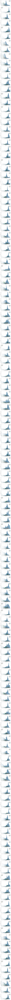

In [87]:
fig, axs = plt.subplots(len(stations), 1, figsize = (8,800))
counter = 0

for station in stations: 
    series = transactions[[station,'working_day']]
    series = series[series[station] > 0]
    series[station] = series[station].transform(np.log)
    sns.histplot(data = series, x= station, hue = 'working_day', ax = axs[counter]);
    counter += 1

In [59]:
k2, p = stats.normaltest(series)
print ('')
# https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.normaltest.html

In [60]:
p

0.0

## 15-mins aggregation

<AxesSubplot:xlabel='timestamp'>

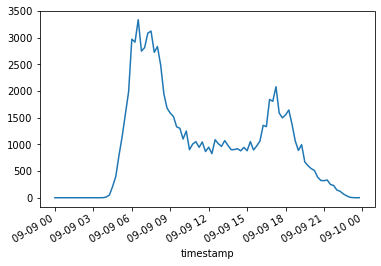

In [131]:
station = '(02000) Cabecera Autopista Norte'
transactions[transactions.date_id == 1500][station].plot()

In [145]:
exp = {'(02000) Cabecera Autopista Norte',
 '(02001) Centro Comercial Santa Fe',
 '(02101) Toberín'}

In [150]:
fig, axs = plt.subplots(nrows = len(stations), ncols = 3, figsize = (24,800), sharey= True)
counter = 0

for station in stations: 
    work_day = transactions[transactions.working_day == 'Week day']['date_id'].sample(1)[0]
    saturday = transactions[transactions.working_day == 'Saturday']['date_id'].sample(1)[0]
    sunday = transactions[transactions.working_day == 'Sunday']['date_id'].sample(1)[0]

    transactions[transactions.date_id == work_day][station].plot(ax = axs[counter][0])
    transactions[transactions.date_id == saturday][station].plot(ax = axs[counter][1])
    transactions[transactions.date_id == sunday][station].plot(ax = axs[counter][2])

    # series = transactions[[station,'working_day']]
    # series = series[series[station] > 0]
    # series[station] = series[station].transform(np.log)
    # sns.histplot(data = series, x= station, hue = 'working_day', ax = axs[counter]);
    counter += 1
